In [1]:
import pandas as pd
from pandas import ExcelFile
import numpy as np
from datetime import datetime
from io import BytesIO
from datetime import datetime, timedelta
import plotly.express as px
import calendar
import math
from plotly.validators.scatter.marker import SymbolValidator
import plotly.graph_objects as go
import plotly.offline as py
py.init_notebook_mode(connected=True)

In [14]:
import requests
import requests_cache
requests_cache.install_cache('NGCP_data')

# NGCP Operations Data is subject to availability and updatedness of the download links 
# Check from https://www.ngcp.ph/operations#operations for updates
NGCPdata_URL = {
    "SystemPeakDemand" : r"https://www.ngcp.ph/Content/uploads/document/operations/System%20Peak.xlsx",
    "EnergyDeliveryPerRegion" : r"https://www.ngcp.ph/Content/uploads/document/operations/Energy%20Delivery%20per%20Region.xlsx",
    "HourlyDemandPerGrid" : r"https://www.ngcp.ph/Content/uploads/document/operations/Hourly%20Demand%20per%20Grid.xlsx",
    "GrossEnergyGenerationPerPlant" : r"https://www.ngcp.ph/Content/uploads/document/operations/Gross%20Energy%20Generation%20Per%20Plant%20Type.xlsx"
}
file_path = NGCPdata_URL.copy()

# check online availability
for data in NGCPdata_URL:
    r = requests.head(NGCPdata_to_URL[data])
    if r.status_code == 200:
        availability = "Available"
        latest_update = r.headers['Last-Modified']
        print(f"{data} => {availability}, File Size: {round(float(r.headers['Content-Length'])/1000)} KB, Last Updated: {latest_update}")
        response = requests.get(file_path[data])
        file_path[data] = response
    elif r.status_code == 404:
        print("Unavailable, using locally cached data")
        # get file saved in local directory
        file_path[data] = file_path[data].split("/")[-1]

SystemPeakDemand => Available, File Size: 144 KB, Last Updated: Mon, 26 Oct 2020 05:46:21 GMT
EnergyDeliveryPerRegion => Available, File Size: 184 KB, Last Updated: Mon, 26 Oct 2020 05:46:12 GMT
HourlyDemandPerGrid => Available, File Size: 3096 KB, Last Updated: Mon, 26 Oct 2020 05:46:19 GMT
GrossEnergyGenerationPerPlant => Available, File Size: 73 KB, Last Updated: Mon, 26 Oct 2020 05:46:16 GMT


In [15]:
# read response or ExcelFile to Pandas DataFrame
file_path

{'SystemPeakDemand': <Response [200]>,
 'EnergyDeliveryPerRegion': <Response [200]>,
 'HourlyDemandPerGrid': <Response [200]>,
 'GrossEnergyGenerationPerPlant': <Response [200]>}

In [18]:
from pandas import ExcelFile
ExcelFile()

TypeError: __init__() missing 1 required positional argument: 'path_or_buffer'

In [6]:



        # file_path[data] = file_path[data]# + "?raw=True"
        
        # download data
        response = sess.get(file_path[data])
        print(response.from_cache)
        file_object = ExcelFile(BytesIO(response.content))
        file_path[data] = file_object
    else:
        print("Unavailable, using locally cached data")
        # get file saved in local directory
        file_path[data] = file_path[data].split("/")[-1]

SystemPeakDemand => Available, File Size: 144 KB, Last Updated: Mon, 26 Oct 2020 05:46:21 GMT => Downloading...
True
EnergyDeliveryPerRegion => Available, File Size: 184 KB, Last Updated: Mon, 26 Oct 2020 05:46:12 GMT => Downloading...
True
HourlyDemandPerGrid => Available, File Size: 3096 KB, Last Updated: Mon, 26 Oct 2020 05:46:19 GMT => Downloading...
True
GrossEnergyGenerationPerPlant => Available, File Size: 73 KB, Last Updated: Mon, 26 Oct 2020 05:46:16 GMT => Downloading...
True


In [5]:
response.from_cache

False

In [16]:
# Energy Delivery Per Region
# read excel workbook into dataframe dict
_df_EnergyDeliveryPerRegion = pd.read_excel(io=file_path["EnergyDeliveryPerRegion"],
    sheet_name=None,
    header=2,
    nrows=30,
    keep_default_na=True,
    usecols='A:M', # only read columns A:M columns | change as needed 
    )

In [21]:
df_EnergyDeliveryPerRegion = _df_EnergyDeliveryPerRegion.copy()
# process each dataframe generated from each sheet corresponding to year
for year in df_EnergyDeliveryPerRegion:
    # remove na rows
    df = df_EnergyDeliveryPerRegion[year].dropna(axis='columns',how='all').dropna(axis='rows',how='all')
    # set multiindex
    multiix_tuples = list(zip(*[['PHILIPPINES']+['LUZON']*11+['VISAYAS']*5+['MINDANAO']*7,
                     df.iloc[:,0]
                               ]))
    multiix = pd.MultiIndex.from_tuples(tuples=multiix_tuples,names=['Island_Group','Region'])
    df.set_index(multiix, inplace=True)
    df.drop(columns=df.columns[0], inplace=True)
    df.replace(to_replace=0, value=np.nan, inplace=True)
    df.columns.name = year
    df.dropna(axis='columns', how='all', inplace=True)
    df.replace(np.NaN, 0, inplace=True)
    df_EnergyDeliveryPerRegion[year] = df
    
next(iter(df_EnergyDeliveryPerRegion.values()))

2020                                                           January  \
Island_Group Region                                                      
PHILIPPINES  TOTAL PHILIPPINES                            6.776316e+06   
LUZON        LUZON                                        5.015094e+06   
             NCR                                          3.491811e+06   
             Total Provincial (Non-Meralco)               1.523284e+06   
             North Luzon                                  1.172411e+06   
             CAR (Cordillera Administrative Region)       1.018937e+05   
             REGION 1 (Ilocos Region)                     2.399030e+05   
             REGION 2 (Cagayan Valley)                    1.210041e+05   
             REGION 3 (Central Luzon)                     7.096103e+05   
             South Luzon                                  3.508727e+05   
             REGION IV-A (CALABARZON)                     2.165565e+05   
             REGION V (BICOL REGION)                      1.343163e+05   
VISAYAS      VISAYAS                                      8.998329e+05   
             REGION VI (WESTERN VISAYAS)                  2.567748e+05   
             REGION VII (CENTRAL VISAYAS)                 5.080750e+05   
             REGION VIII (EASTERN VISAYAS)                1.349831e+05   
             NIR (Negros Island Region)                   0.000000e+00   
MINDANAO     MINDANAO                                     8.613885e+05   
             REGION IX (ZAMBOANGA PENINSULA)              1.239213e+05   
             REGION X (NORTHERN MINDANAO)                 1.780639e+05   
             REGION XI (DAVAO REGION)                     3.151581e+05   
             REGION XII (Soccskargen)                     1.502076e+05   
             REGION XIII (CARAGA)                         8.444592e+04   
             ARMM (Autonomous Region in Muslim Mindanao)  9.591701e+03   

2020                                                          February  \
Island_Group Region                                                      
PHILIPPINES  TOTAL PHILIPPINES                            6.940194e+06   
LUZON        LUZON                                        5.116274e+06   
             NCR                                          3.609054e+06   
             Total Provincial (Non-Meralco)               1.507221e+06   
             North Luzon                                  1.138752e+06   
             CAR (Cordillera Administrative Region)       1.027079e+05   
             REGION 1 (Ilocos Region)                     2.276561e+05   
             REGION 2 (Cagayan Valley)                    1.132834e+05   
             REGION 3 (Central Luzon)                     6.951044e+05   
             South Luzon                                  3.684689e+05   
             REGION IV-A (CALABARZON)                     2.306360e+05   
             REGION V (BICOL REGION)                      1.378329e+05   
VISAYAS      VISAYAS                                      9.437061e+05   
             REGION VI (WESTERN VISAYAS)                  2.602359e+05   
             REGION VII (CENTRAL VISAYAS)                 5.386064e+05   
             REGION VIII (EASTERN VISAYAS)                1.448639e+05   
             NIR (Negros Island Region)                   0.000000e+00   
MINDANAO     MINDANAO                                     8.802139e+05   
             REGION IX (ZAMBOANGA PENINSULA)              1.246676e+05   
             REGION X (NORTHERN MINDANAO)                 1.800731e+05   
             REGION XI (DAVAO REGION)                     3.295329e+05   
             REGION XII (Soccskargen)                     1.516565e+05   
             REGION XIII (CARAGA)                         8.422198e+04   
             ARMM (Autonomous Region in Muslim Mindanao)  1.006173e+04   

2020                                                             March  \
Island_Group Region                                                      
PH

In [22]:
df_EnergyDeliveryPerRegion_year = pd.DataFrame()
for year in df_EnergyDeliveryPerRegion:
    df = df_EnergyDeliveryPerRegion[year].reset_index()
    df = df.melt(id_vars=["Island_Group","Region"], value_name="Energy_Delivery(MWh)")
    df.insert(loc=2, column="Year", value=year)
    df.rename(columns={year : "Month"}, inplace=True)
    df = df[~df["Region"].isin(["TOTAL PHILIPPINES","LUZON","VISAYAS","MINDANAO","North Luzon","South Luzon","Total Provincial (Non-Meralco)"])]
    df_EnergyDeliveryPerRegion_year = df_EnergyDeliveryPerRegion_year.append(df)
# set column dtypes
df_EnergyDeliveryPerRegion_year["Month"] = pd.Categorical(values=df_EnergyDeliveryPerRegion_year["Month"], categories=list(calendar.month_name), ordered=True)
df_EnergyDeliveryPerRegion_year

,Island_Group,Region,Year,Month,Energy_Delivery(MWh)
2,LUZON,NCR,2020,January,3.491811e+06
5,LUZON,CAR (Cordillera Administrative Region),2020,January,1.018937e+05
6,LUZON,REGION 1 (Ilocos Region),2020,January,2.399030e+05
7,LUZON,REGION 2 (Cagayan Valley),2020,January,1.210041e+05
8,LUZON,REGION 3 (Central Luzon),2020,January,7.096103e+05
...,...,...,...,...,...
271,MINDANAO,REGION X (NORTHERN MINDANAO),2013,December,1.850381e+05
272,MINDANAO,REGION XI (DAVAO REGION),2013,December,2.164635e+05
273,MINDANAO,REGION XII (Soccskargen),2013,December,1.264170e+05
274,MINDANAO,REGION XIII (CARAGA),2013,December,6.326886e+04


In [15]:
df = df_EnergyDeliveryPerRegion_year[df_EnergyDeliveryPerRegion_year['Year']=="2020"].sort_values(by=['Month','Energy_Delivery(MWh)'], ascending=[True,False])
fig = px.area(
    template='plotly_white',
    height=600,
    # data
    data_frame=df, 
    x="Month", 
    y="Energy_Delivery(MWh)",
    # color and grouping
    color="Island_Group",
    color_discrete_sequence = px.colors.sequential.thermal[1::2],
    line_group="Region",
    # hover settings
    hover_name='Region',
    hover_data={
        'Island_Group': False,
        'Region': False,
        'Month': False,
        'Energy_Delivery(MWh)': True
    }
)
fig.update_traces(
    mode='markers+lines',
    hovertemplate='%{customdata[1]}: %{customdata[3]:.0f} MW<extra></extra>'
)
island_groups = ["Luzon","Visayas","Mindanao"]
islandgroup_to_marker = dict(zip(island_groups, ['circle','square','diamond']))
for island_group in island_groups:
    fig.update_traces(selector=({'name':island_group.upper()}), marker={'opacity':0.75, 'symbol':islandgroup_to_marker.get(island_group)})

fig.show()

NameError: name 'df_EnergyDeliveryPerRegion_year' is not defined

In [45]:
df_EnergyDeliveryPerRegion_year[df_EnergyDeliveryPerRegion_year['Energy_Delivery(MWh)'].isna() == True]

,Island_Group,Region,Year,Month,Energy_Delivery(MWh)


In [43]:
df_EnergyDeliveryPerRegion_year[df_EnergyDeliveryPerRegion_year['Energy_Delivery(MWh)'].isna()['Energy_Delivery(MWh)']==True]

KeyError: 'Energy_Delivery(MWh)'

In [42]:
df_EnergyDeliveryPerRegion_year

,Island_Group,Region,Year,Month,Energy_Delivery(MWh)
2,LUZON,NCR,2020,January,3.491811e+06
5,LUZON,CAR (Cordillera Administrative Region),2020,January,1.018937e+05
6,LUZON,REGION 1 (Ilocos Region),2020,January,2.399030e+05
7,LUZON,REGION 2 (Cagayan Valley),2020,January,1.210041e+05
8,LUZON,REGION 3 (Central Luzon),2020,January,7.096103e+05
...,...,...,...,...,...
271,MINDANAO,REGION X (NORTHERN MINDANAO),2013,December,1.850381e+05
272,MINDANAO,REGION XI (DAVAO REGION),2013,December,2.164635e+05
273,MINDANAO,REGION XII (Soccskargen),2013,December,1.264170e+05
274,MINDANAO,REGION XIII (CARAGA),2013,December,6.326886e+04


In [37]:
df

,Island_Group,Year,Month,Energy_Delivery(MWh)
0,LUZON,2013,,NaN
1,LUZON,2013,January,500216.065000
2,LUZON,2013,February,561712.467734
3,LUZON,2013,March,538601.193867
4,LUZON,2013,April,627891.694634
...,...,...,...,...
307,VISAYAS,2020,August,227154.058671
308,VISAYAS,2020,September,234736.736518
309,VISAYAS,2020,October,NaN
310,VISAYAS,2020,November,NaN


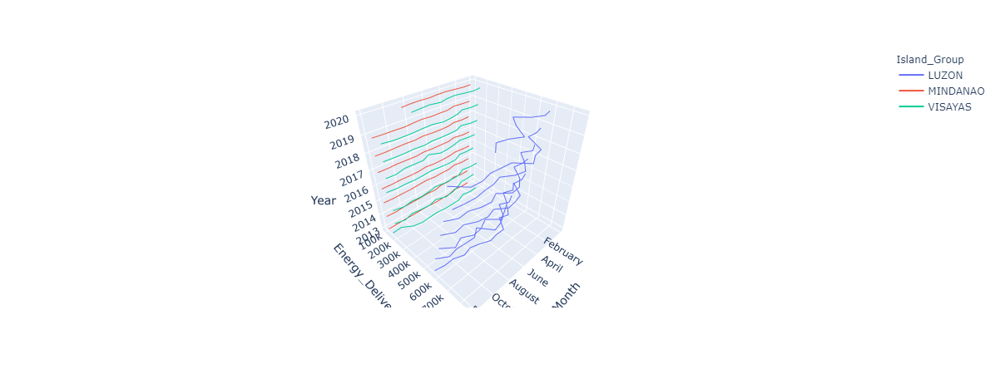

In [46]:
df = df_EnergyDeliveryPerRegion_year.groupby(by=['Island_Group','Year','Month']).mean().reset_index()
fig = px.line_3d(
    data_frame=df, x='Month', y='Energy_Delivery(MWh)', z='Year',
    line_group='Year',
    color='Island_Group'
)
fig.show()

In [7]:
## System Peak Demand
_df_SystemPeakDemand = pd.read_excel(io=file_path["SystemPeakDemand"],
    sheet_name="System Peak",
    header=4,
    nrows=12,
    keep_default_na=True,
    index_col=0
    )
_df_SystemPeakDemand.dropna(axis='columns', how='all', inplace=True)
# drop extra month columns
month_ix = _df_SystemPeakDemand.iloc[0,:][pd.Index(_df_SystemPeakDemand.iloc[0,:]).get_loc("Jan")].index
_df_SystemPeakDemand.drop(columns=month_ix, inplace=True)

In [8]:
df_SystemPeakDemand = _df_SystemPeakDemand.copy()
# select datetime columns
df_SystemPeakDemand_Datetime = df_SystemPeakDemand.select_dtypes(include=['datetime64'])
# change column names to years
year = datetime.now().year
years_arr = range(2013,year+1)
_init_cols = df_SystemPeakDemand_Datetime.columns
df_SystemPeakDemand_Datetime.columns = list(years_arr)*3

# define function to replace year and/or month of timestamp
def fix_year_month(ts,year,month):
    if (ts.year == year) & (ts.month == month):
        return ts
    else:
        try:
            ts_ = ts.replace(year=year, month=month)
        except ValueError:
            ts_ = ts.replace(year=year, month=month, day=calendar.monthrange(year, month)[1])
        return ts_
# fix incorrect month and/or year
month_to_num = { v:k for k,v in dict(enumerate(calendar.month_abbr, 0)).items() }
for _,month_series in df_SystemPeakDemand_Datetime.iterrows():
    to_month = month_to_num.get(month_series.name)
    # apply fix function to series
    df_SystemPeakDemand.loc[month_series.name,_init_cols] = pd.Series(
        data=list(map(lambda tupl: fix_year_month(ts=tupl[1],year=tupl[0],month=to_month), month_series.items())),
        index=_init_cols,
        name=month_series.name
    )
# convert data tables into tidy data
ncols = df_SystemPeakDemand.shape[1]
df = pd.DataFrame()
for i in range(0,ncols,3):
    df_t = df_SystemPeakDemand.iloc[:,i:i+3]
    df_t.columns = ["Peak_Demand(MW)","Date","Time"]
    df = df.append(df_t, ignore_index=True)
# assign corresponding island group
nrows = 12*(year-2013+1)
island_groups = ["Luzon","Visayas","Mindanao"]
df.loc[0:nrows,"Island_Group"], df.loc[nrows:nrows*2, "Island_Group"], df.loc[nrows*2:nrows*3, "Island_Group"] = island_groups
# drop na
df.dropna(axis='index', inplace=True)

# add DateTime, Year, Month columns
df["Dt_Occurrence"] = pd.to_datetime(df["Date"].astype('str') + " " + df["Time"].str.lower().str.rstrip("h"))
df["Year"], df["Month"] = df["Dt_Occurrence"].dt.year, df["Dt_Occurrence"].dt.month_name()
df["Dt_Occurrence_F"] = df["Dt_Occurrence"].apply(lambda dt: datetime.strftime(dt,"%a %b-%d %I:%M%p"))

# reassign as main df
df_SystemPeakDemand = df[["Island_Group","Peak_Demand(MW)","Year","Month","Dt_Occurrence","Dt_Occurrence_F"]]
# assign dtypes
df_SystemPeakDemand = df_SystemPeakDemand.astype(dtype={
    "Island_Group" : 'category',
    "Peak_Demand(MW)" : float,
    "Year" : int,
    "Month" : 'category',
    "Dt_Occurrence" : 'datetime64[ns]',
    "Dt_Occurrence_F" :str
})

In [9]:
df_SystemPeakDemand.pivot_table(index="Island_Group", columns= ["Year","Month"], values="Peak_Demand(MW)")

Year              2013                                                \
Month            April  August  December February   January     July   
Island_Group                                                           
Luzon         8178.000  7755.0  7670.000  7214.00  7079.000  8030.00   
Mindanao      1226.046  1326.3  1427.755  1244.01  1284.137  1383.52   
Visayas       1547.800  1511.9  1349.930  1445.81  1462.810  1542.77   

Year                                                 ...      2019      2020  \
Month             June     March      May  November  ... September     April   
Island_Group                                         ...                       
Luzon         8208.000  7720.000  8305.00  7488.000  ...   10392.0  8377.000   
Mindanao      1364.278  1245.022  1365.72  1396.737  ...    1960.0  1673.428   
Visayas       1554.680  1527.890  1572.33  1517.940  ...    2164.0  1789.400   

Year                                                                           \
Month               August February January       July          June    March   
Island_Group                                                                    
Luzon         10422.000000   9889.0  9713.0  10595.000  10642.000000  11103.0   
Mindanao       1911.366000   1977.0  1960.0   1867.284   1907.407000   1953.0   
Visayas        2079.664618   2201.0  2066.0   1911.600   2043.565554   2140.0   

Year                              
Month              May September  
Island_Group                      
Luzon         9639.000   10570.0  
Mindanao      1798.166    1944.0  
Visayas       1965.600    2098.0  

[3 rows x 93 columns]

In [10]:
max_pd_luz,min_pd_luz = df_SystemPeakDemand[df_SystemPeakDemand["Island_Group"]=="Luzon"]["Peak_Demand(MW)"].max(),df_SystemPeakDemand[df_SystemPeakDemand["Island_Group"]=="Luzon"]["Peak_Demand(MW)"].min()
max_pd_vis,min_pd_vis = df_SystemPeakDemand[df_SystemPeakDemand["Island_Group"]=="Visayas"]["Peak_Demand(MW)"].max(),df_SystemPeakDemand[df_SystemPeakDemand["Island_Group"]=="Visayas"]["Peak_Demand(MW)"].min()
max_pd_min,min_pd_min = df_SystemPeakDemand[df_SystemPeakDemand["Island_Group"]=="Mindanao"]["Peak_Demand(MW)"].max(),df_SystemPeakDemand[df_SystemPeakDemand["Island_Group"]=="Mindanao"]["Peak_Demand(MW)"].min()
luz_yscale,vis_yscale,min_yscale = (math.floor(min_pd_luz/500)*500, math.ceil(max_pd_luz/500)*500),(math.floor(min_pd_vis/500)*500, math.ceil(max_pd_vis/500)*500),(math.floor(min_pd_min/500)*500, math.ceil(max_pd_min/500)*500)

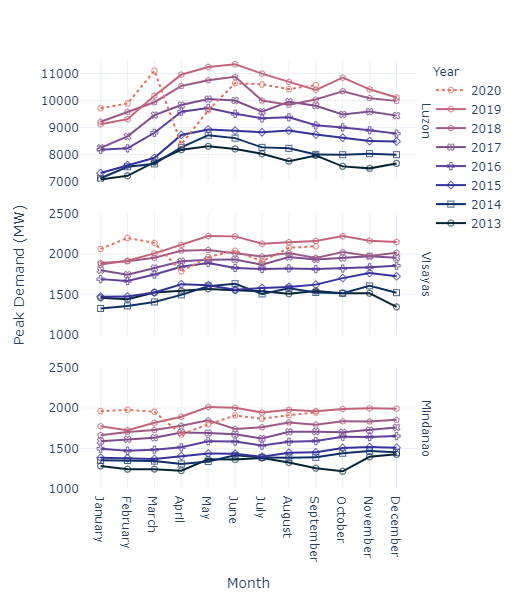

In [11]:
fig = px.line(
    data_frame=df_SystemPeakDemand, 
    x=df_SystemPeakDemand["Month"], 
    y="Peak_Demand(MW)",
    color="Year",
    facet_row="Island_Group",
    line_group="Island_Group",
    #line_dash="Year",
    facet_row_spacing=0.075,
    color_discrete_sequence = px.colors.sequential.thermal,
    #color_discrete_sequence = px.colors.sequential.Plasma,
    custom_data=["Dt_Occurrence_F"],
    hover_data= {
        "Peak_Demand(MW)": True,
        "Island_Group": True,
        "Year": True,
        "Month": False,
        "Dt_Occurrence_F":True
    },
    labels = {
        "Peak_Demand(MW)": "Peak Demand(MW)",
        "Island_Group": "Island Group",
        "Dt_Occurrence_F" : "Occurred"
    },
    template='plotly_white',
    height=600
)
#print(fig.data[0].hovertemplate)
# change trace and hover template
fig.update_traces(
    mode='markers+lines',
    marker=dict(opacity=0.75),
    hovertemplate='%{customdata[3]}: %{customdata[1]:.0f} MW on %{customdata[0]}<extra></extra>'
)
# change trace shape to dot if year is still incomplete
if len(df_SystemPeakDemand[df_SystemPeakDemand["Year"]==year]["Month"].unique()) != 12:
    fig.update_traces(
        selector={'name':str(year)},
        line= {'dash': 'dot'}
    )

# different y axis scale
fig.update_yaxes(matches=None, range=min_yscale, selector={'anchor':'x'})
fig.update_yaxes(matches=None, range=vis_yscale, selector={'anchor':'x2'})
fig.update_yaxes(matches=None, range=luz_yscale, selector={'anchor':'x3'})
fig.update_yaxes(tickformat='.0f')
# set x axis `Month` to categorical
fig.update_xaxes(type='category')
# remove '=' in facet annotation
fig.for_each_annotation(lambda an: an.update(text=an.text.split("=")[-1]))
# remove all y-axis labels except middle
fig.for_each_yaxis(lambda yaxis: yaxis.update(title={'text':"Peak Demand (MW)"}) if yaxis.anchor=='x2' else yaxis.update(title=None))
# 
fig.update_layout(
    hovermode='x unified',
    legend={'traceorder':'reversed'}
)

# update marker shapes
year = datetime.now().year
years = range(2013, year+1)
marker_shapes = list(filter(lambda e: (type(e)==str) 
            and (e.isnumeric()==False)
            and ('triangle' not in e.split('-')) 
            and ('open' in e.split('-')) 
            and ('dot' not in e.split('-'))
            , SymbolValidator().values))
marker_shapes = marker_shapes[0:len(list(years))]
year_to_marker = dict((zip(years,marker_shapes)))
for year in years:
    fig.update_traces(selector=({'name':str(year)}), marker={'symbol':year_to_marker.get(year)})
fig.show()

## Hourly Demand

In [49]:
# Hourly Demand Per Grid
# read excel workbook into dataframe dict
_df_HourlyDemandPerGrid = pd.read_excel(io=file_path["HourlyDemandPerGrid"],
    sheet_name=None,
    header=2,
    keep_default_na=True,
    )

In [50]:
# convert to time-series 'long' data
# hour 1 corresponds to 1:00am GMT+8 ... hour 2: 2:00am GMT+8 .. and so on until hour 24: 12:00am GMT+8
df = _df_HourlyDemandPerGrid['LUZON HOURLY LOAD 2013-2020']
df = df.melt(id_vars=['DATE'], var_name='Hour', value_name='Load (MW)')
df.rename(columns={'DATE':'Date'}, inplace=True)
df['Datetime'] = df['Date'] + df['Hour'].apply(lambda h: timedelta(hours=h - 1))
df['Month'] = df['Datetime'].dt.month
# sort
df.sort_values(by='Datetime', inplace=True)
# daily rolling mean
df['24-h rolling mean)'] = df['Load (MW)'].rolling(window=24, center=True).mean()
# 7-d rolling mean
df['7-d rolling mean'] = df['Load (MW)'].rolling(window=24*7, center=True).mean()
# 365-d rolling mean
df['Trend (365-d rolling mean)'] = df['Load (MW)'].rolling(window=24*365, center=True).mean()
df

,Date,Hour,Load (MW),Datetime,Month,24-h rolling mean),7-d rolling mean,Trend (365-d rolling mean)
0,2013-01-01,1,4303,2013-01-01 00:00:00,1,NaN,NaN,NaN
2830,2013-01-01,2,3918,2013-01-01 01:00:00,1,NaN,NaN,NaN
5660,2013-01-01,3,3709,2013-01-01 02:00:00,1,NaN,NaN,NaN
8490,2013-01-01,4,3529,2013-01-01 03:00:00,1,NaN,NaN,NaN
11320,2013-01-01,5,3450,2013-01-01 04:00:00,1,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
56599,2020-09-30,20,9132,2020-09-30 19:00:00,9,NaN,NaN,NaN
59429,2020-09-30,21,9194,2020-09-30 20:00:00,9,NaN,NaN,NaN
62259,2020-09-30,22,9093,2020-09-30 21:00:00,9,NaN,NaN,NaN
65089,2020-09-30,23,8759,2020-09-30 22:00:00,9,NaN,NaN,NaN


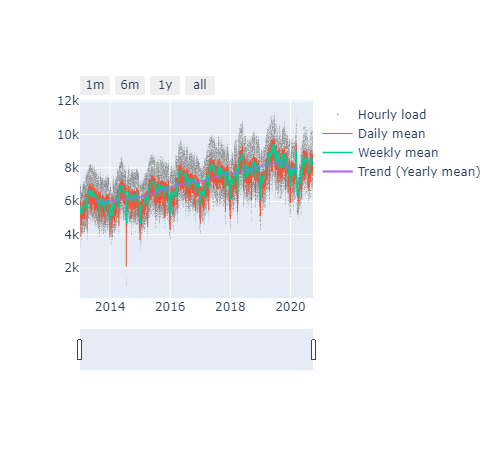

In [51]:
fig = go.Figure()
fig.add_trace(
    go.Scattergl(
        name="Hourly load", x=df['Datetime'], y=df['Load (MW)'],
        mode='markers', marker = {
                            'size' : 0.5,
                            'opacity' : 0.5,
                            'color' : 'gray'
                        }
    )
)
fig.add_trace(
    go.Scattergl(
        name="Daily mean", x=df['Datetime'], y=df['24-h rolling mean)'],
        mode='lines', line={'width':1}
    )
)
fig.add_trace(
    go.Scattergl(
        name="Weekly mean",
        x=df['Datetime'], 
        y=df['7-d rolling mean'],
        mode='lines',
        line={'width':1.5}
    )
)
fig.add_trace(
    go.Scattergl(
        name="Trend (Yearly mean)",
        x=df['Datetime'], 
        y=df['Trend (365-d rolling mean)'],
        mode='lines',
        line={'width':2}
    )
)

#fig.update_layout(
#    template='plotly_white'
#)

# add range selector
minx,maxx = df['Datetime'].min(),df['Datetime'].max()
fig.update_xaxes(
    type='date',
    range=(minx,maxx),
    rangeslider_visible=True,
    rangeslider={
        'range': (minx,maxx),
        'visible': True
    },
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="1y", step="year", stepmode="todate"),
            dict(step="all")
        ])
    )
)

fig.show()

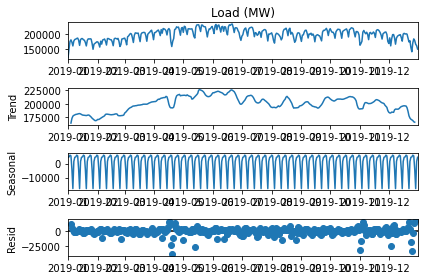

In [91]:
from statsmodels.tsa.seasonal import seasonal_decompose
df_d = df.set_index("Datetime")["Load (MW)"]
df_d = df_d[df_d.index.year == 2019]
df_d = df_d.resample('D').sum()
result = seasonal_decompose(df_d, model='additive')
result.plot();

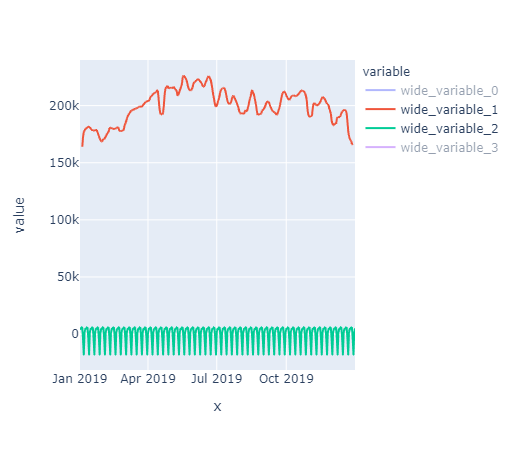

In [92]:
px.line(
    x = result.observed.index,
    y = [result.observed, result.trend, result.seasonal, result.resid],
    facet_row=
)

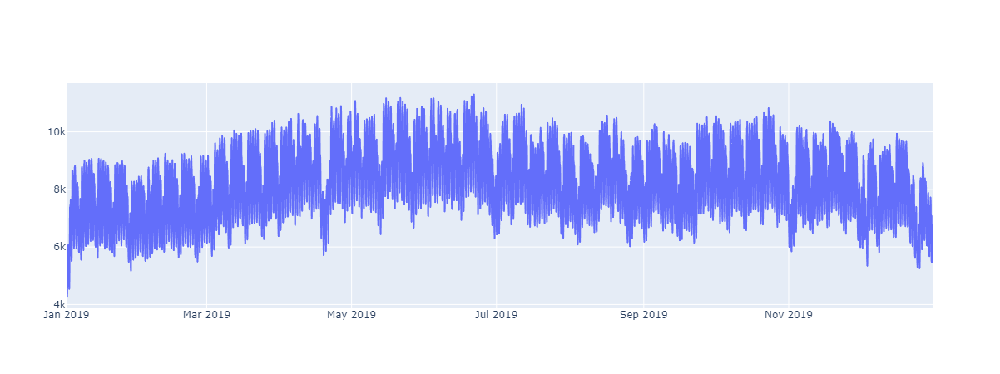

In [88]:
fig = go.Figure()
fig.add_trace(
    go.Scattergl(
    x = result.observed.index,
    y = 
    )
)
fig.add_trace(
    go.Scattergl(
    x = result.observed.index,
    y = result.observed
    )
)

In [70]:
result

(365,)

In [93]:
## Energy Generation